<a href="https://colab.research.google.com/github/Shuayb007/CybersecurityBreach/blob/main/Breach_Top2Vec.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install --upgrade pip
!pip install --upgrade jupyter notebook
!pip install top2vec
!pip install top2vec[sentence_encoders]
!pip install top2vec[sentence_transformers]
!pip install top2vec[indexing]

In [ ]:
import pandas as pd
import numpy as np
from top2vec import Top2Vec
import matplotlib.pyplot as plt
import seaborn as sns
import re
import gensim
from gensim.models import Phrases
from gensim.models.phrases import Phraser
from gensim.parsing.preprocessing import STOPWORDS

In [ ]:
# load the data

breach_df = pd.read_csv("/Users/shuaibismail/Documents/Graduate Research/Data Breach Chronology.csv")

In [ ]:
!pwd

/content


In [ ]:
breach_df

,Date Made Public,Company,City,State,Type of breach,Type of organization,Total Records,Description of incident,Information Source,Source URL,Year of Breach,Latitude,Longitude,Unnamed: 13,Unnamed: 14,Unnamed: 15,Description
0,3/3/2006,PayDay OK LLC,NaN,New Jersey,HACK,BSF,88,The company's website was breached sometime ar...,California Attorney General,https://oag.ca.gov/,2006,40.058324,-74.405661,NaN,NaN,NaN,the company website was breached sometime arou...
1,1/4/2012,"SF Fire Credit Union, Pacifica-Coastside Credi...",San Francisco,California,PORT,BSF,0,"The December 29, 2011 theft of a laptop from a...",California Attorney General,NaN,2012,37.774930,-122.419416,NaN,NaN,NaN,the december 29 2011 theft of a laptop from a ...
2,2/18/2012,"BDO USA, Rubio's Restaurants, Inc.",San Diego,California,PORT,BSR,0,BDO was contracted by Rubio's to perform finan...,California Attorney General,NaN,2012,32.715329,-117.157255,NaN,NaN,NaN,bdo was contracted by rubio to perform financi...
3,2/22/2012,"DHI Mortgage Company, Ltd.",Austin,Texas,HACK,BSF,0,"On February 10, 2012, DHI Mortgage became awar...",California Attorney General,NaN,2012,30.267153,-97.743061,NaN,NaN,NaN,on february 10 2012 dhi mortgage became aware ...
4,3/12/2012,"Impairment Resources, LLC",San Diego,California,PORT,MED,"14,000",An office burglary on New Year's Eve 2011 resu...,California Attorney General,NaN,2012,32.715329,-117.157255,NaN,NaN,NaN,an office burglary on new year eve 2011 result...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9010,11/20/2009,"Mark D. Lurie, MD",NaN,CA,PHYS,MED,5166,Location of breached information: Theft\nBusin...,US Department of Health and Human Services,https://ocrportal.hhs.gov/ocr/breach/breach_re...,2009,NaN,NaN,NaN,NaN,NaN,location of breached information theft\nbusine...
9011,11/17/2009,Health Services for Children with Special Need...,NaN,DC,PHYS,MED,3800,Location of breached information: Loss\nBusine...,US Department of Health and Human Services,https://ocrportal.hhs.gov/ocr/breach/breach_re...,2009,NaN,NaN,NaN,NaN,NaN,location of breached information loss\nbusines...
9012,10/30/2009,Alaska Department of Health and Social Services,NaN,AK,PHYS,MED,501,Location of breached information: Theft\nBusin...,US Department of Health and Human Services,https://ocrportal.hhs.gov/ocr/breach/breach_re...,2009,NaN,NaN,NaN,NaN,NaN,location of breached information theft\nbusine...
9013,10/28/2009,"Mid America Kidney Stone Association, LLC",NaN,MO,PHYS,MED,1000,Location of breached information: Theft\nBusin...,US Department of Health and Human Services,https://ocrportal.hhs.gov/ocr/breach/breach_re...,2009,NaN,NaN,NaN,NaN,NaN,location of breached information theft\nbusine...


In [ ]:
clean_doc[5]

'insurance services aware vulnerability network resulted exposure electronic files information secured files accessible period weeks late september early october client names social security numbers driver license numbers medical conditions exposed'

In [ ]:
docs = list(breach_df.values)

In [ ]:
for i in range(len(docs)):
    docs[i] = str(docs[i])

In [ ]:
top2vec_model = Top2Vec(documents=docs, speed='deep-learn', workers=8)

2021-11-05 14:57:04,138 - top2vec - INFO - Pre-processing documents for training
2021-11-05 14:57:07,567 - top2vec - INFO - Creating joint document/word embedding
2021-11-05 15:32:31,144 - top2vec - INFO - Creating lower dimension embedding of documents
2021-11-05 15:32:39,659 - top2vec - INFO - Finding dense areas of documents
2021-11-05 15:32:39,943 - top2vec - INFO - Finding topics


In [ ]:
top2vec_model.get_num_topics()

44

In [ ]:
top2vec_model.save("/Users/shuaibismail/Documents/Graduate Research/top2vec_model")
model_load = Top2Vec.load("/Users/shuaibismail/Documents/Graduate Research/top2vec_model")

In [ ]:
topic_words, word_scores, topic_nums = top2vec_model.get_topics(44)

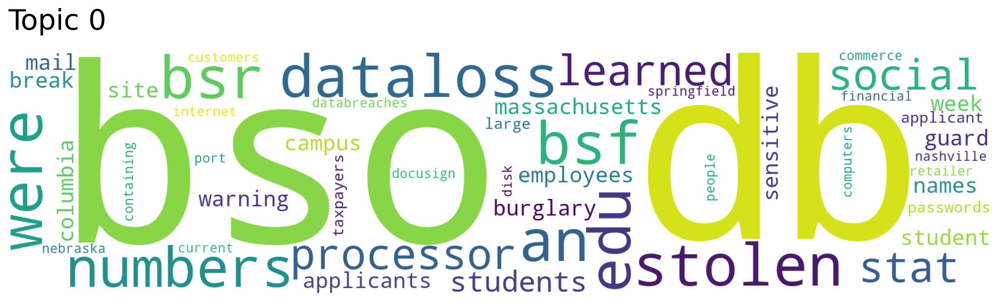

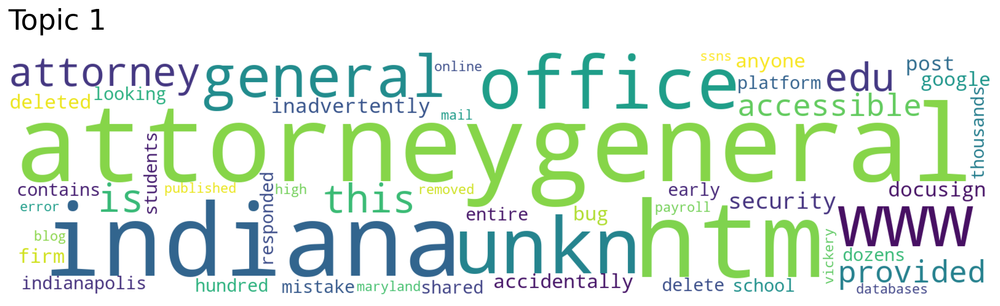

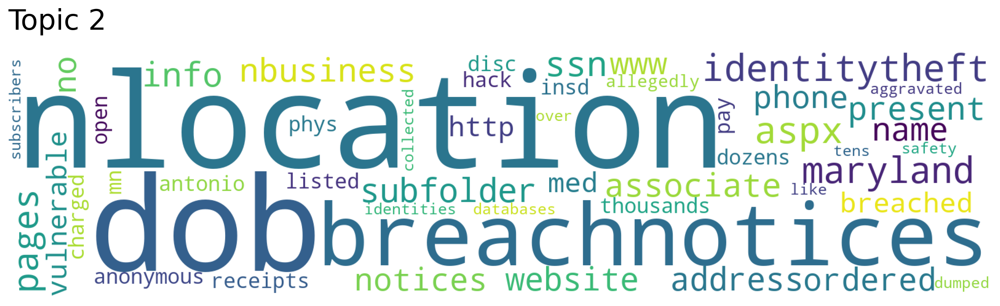

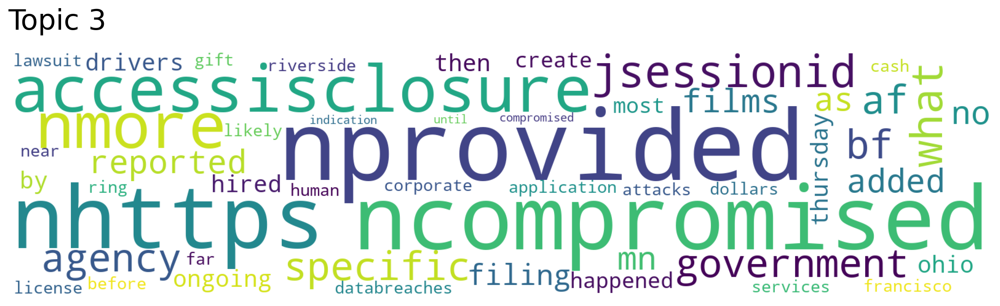

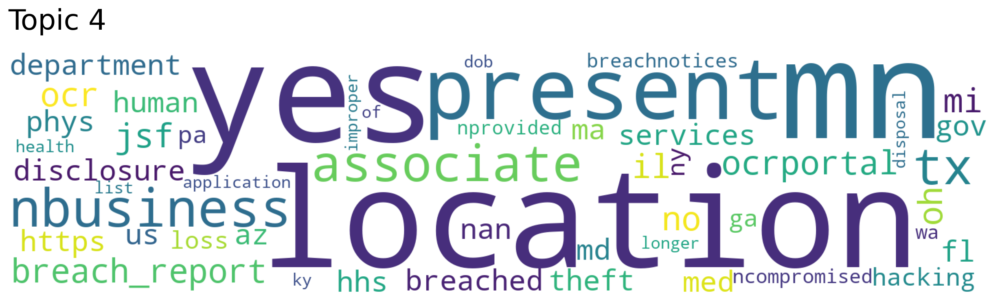

...

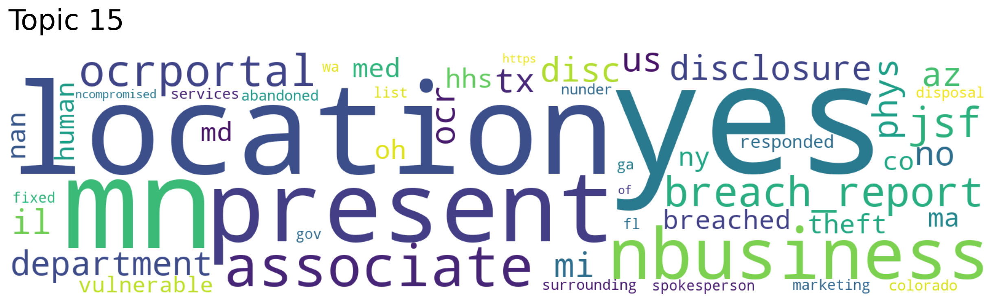

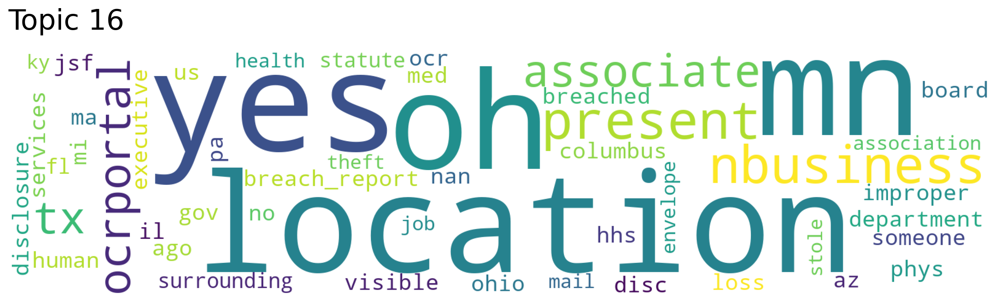

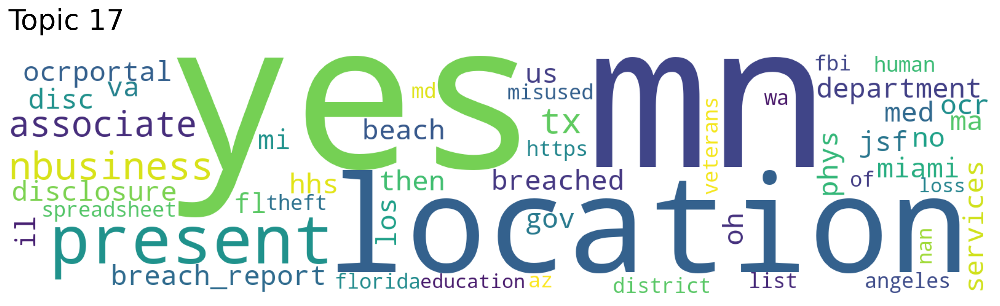

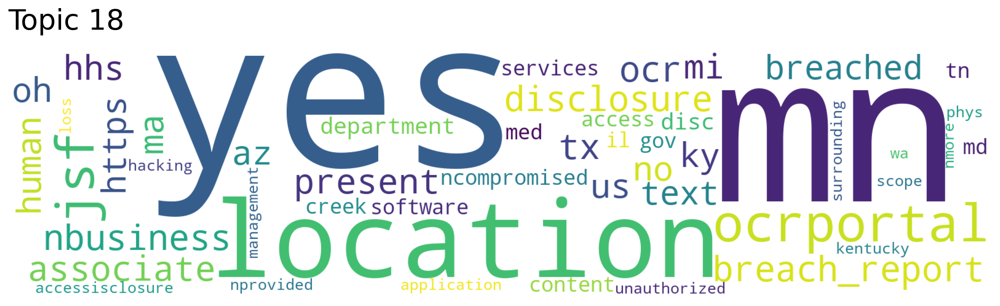

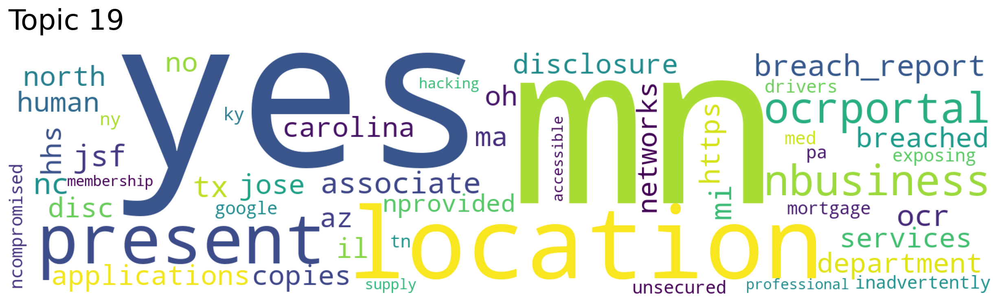

In [ ]:
for topic in topic_nums[0:20]:
    top2vec_model.generate_topic_wordcloud(topic, background_color="White")

In [ ]:
##Using Top2Vec for Semantic Search

"What is known about what was stolen in a breach?"

Search Topics
Discover topics relevant to Hack and Company types of breaches.

/opt/anaconda3/lib/python3.8/site-packages/top2vec/Top2Vec.py:2416: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(16, 4),


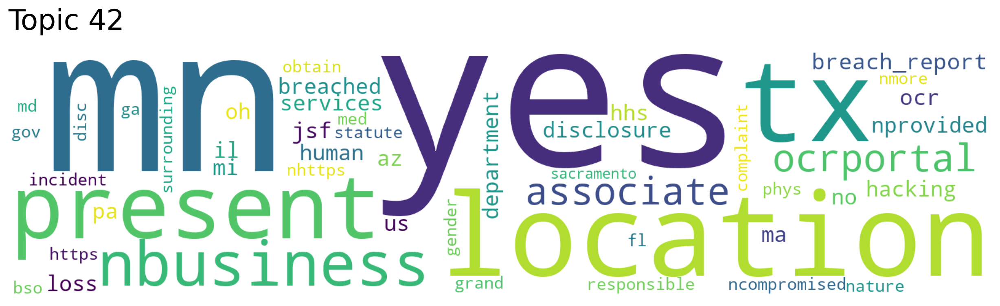

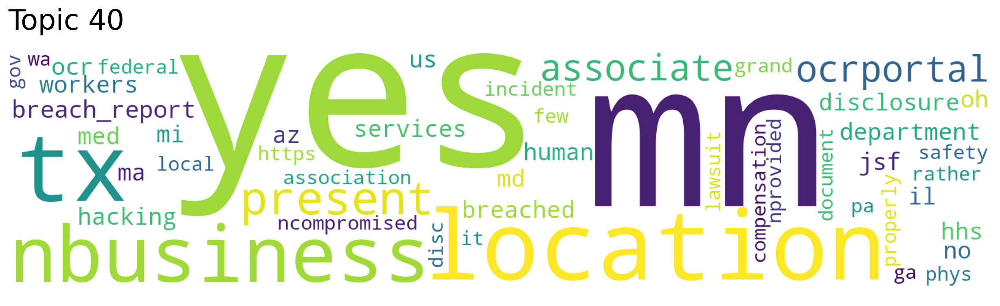

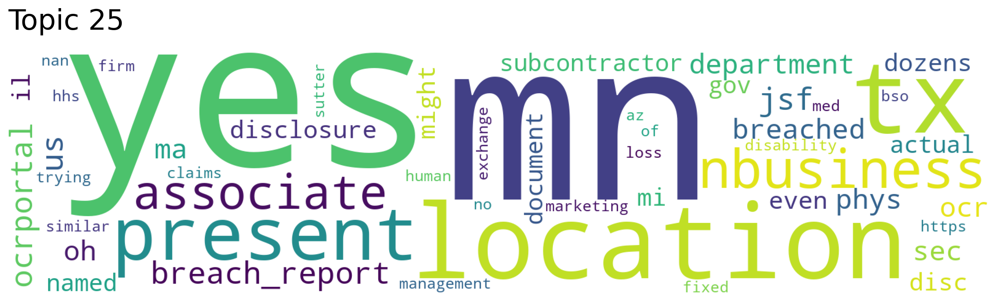

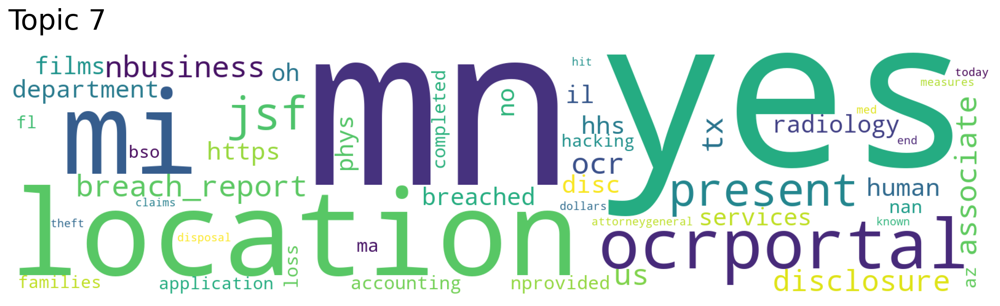

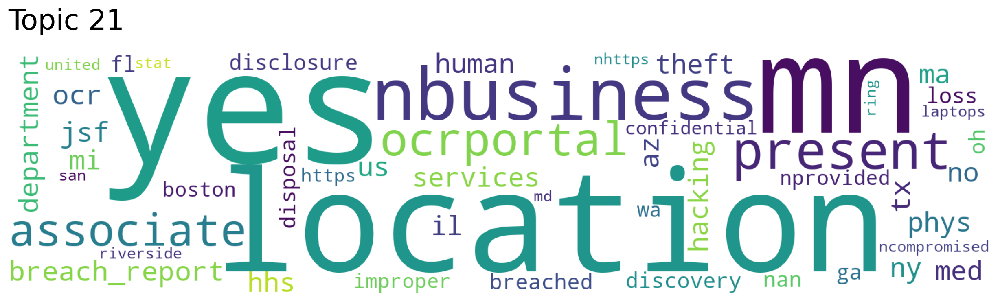

...

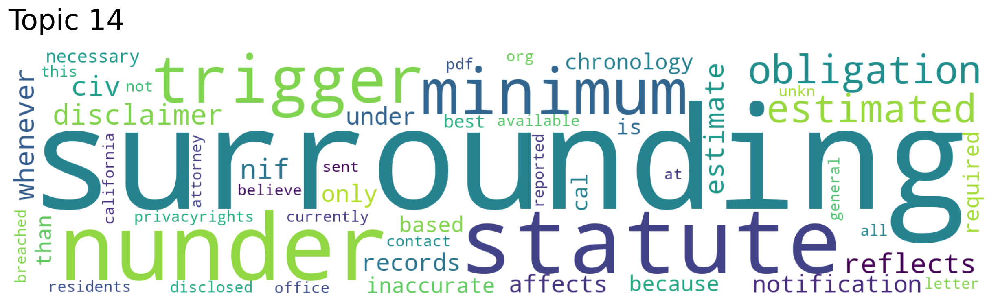

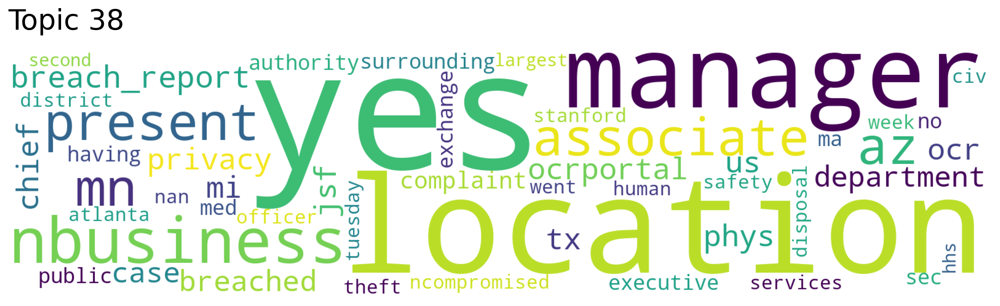

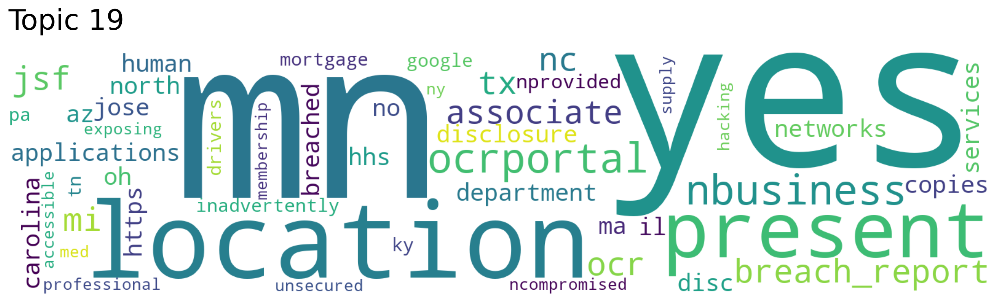

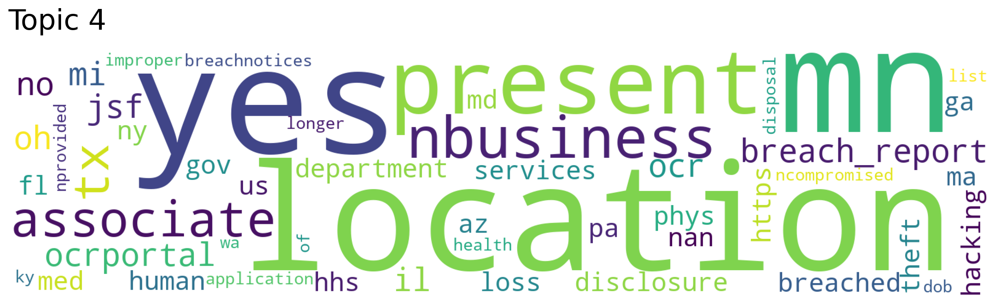

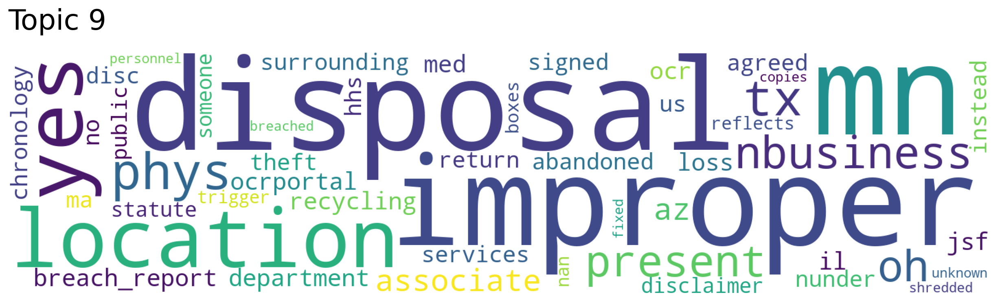

In [ ]:
topic_words, word_scores, topic_scores, topic_nums = top2vec_model.search_topics(keywords=["HACK", "Company"],num_topics=0)
for topic in topic_nums:
    top2vec_model.generate_topic_wordcloud(topic, background_color="White")

In [ ]:
Search document by Topic
Search by topic 1, which appears to what was sto.

documents, document_scores, document_nums = top2vec_model.search_documents_by_topic(topic_num=1, num_docs=6)
    
result_df = breach_df.loc[document_nums]
result_df["document_scores"] = document_scores

for index,row in result_df.iterrows():
    print(f"Document: {index}, Score: {row.document_scores}")
    print(f"Company: {row.Company}")
    print(f"State: {row.State}")
    print("-----------")
    print("-----------")
    print({row.})
    print()

In [ ]:
#Similar Keywords
#Search for similar words to hack.

words, word_scores = model.similar_words(keywords=["hack"], keywords_neg=[], num_words=10)
for word, score in zip(words, word_scores):
    print(f"{word} {score}")
